In [167]:
import torch
from torch.utils.data import Dataset, DataLoader
from torch.nn.utils.rnn import pad_sequence
from sklearn.model_selection import train_test_split
import numpy as np
import torch.nn as nn
import torch.optim as optim
import string
import pandas as pd
import re

In [168]:
df = pd.read_csv('train.csv')
text = df['text'].iloc[0]

In [169]:
text

"First Citizen:\nBefore we proceed any further, hear me speak.\n\nAll:\nSpeak, speak.\n\nFirst Citizen:\nYou are all resolved rather to die than to famish?\n\nAll:\nResolved. resolved.\n\nFirst Citizen:\nFirst, you know Caius Marcius is chief enemy to the people.\n\nAll:\nWe know't, we know't.\n\nFirst Citizen:\nLet us kill him, and we'll have corn at our own price.\nIs't a verdict?\n\nAll:\nNo more talking on't; let it be done: away, away!\n\nSecond Citizen:\nOne word, good citizens.\n\nFirst Citizen:\nWe are accounted poor citizens, the patricians good.\nWhat authority surfeits on would relieve us: if they\nwould yield us but the superfluity, while it were\nwholesome, we might guess they relieved us humanely;\nbut they think we are too dear: the leanness that\nafflicts us, the object of our misery, is as an\ninventory to particularise their abundance; our\nsufferance is a gain to them Let us revenge this with\nour pikes, ere we become rakes: for the gods know I\nspeak this in hunger 

In [170]:
sentences = re.split(r'[.!?]\s*', text)
sentences

['First Citizen:\nBefore we proceed any further, hear me speak',
 'All:\nSpeak, speak',
 'First Citizen:\nYou are all resolved rather to die than to famish',
 'All:\nResolved',
 'resolved',
 'First Citizen:\nFirst, you know Caius Marcius is chief enemy to the people',
 "All:\nWe know't, we know't",
 "First Citizen:\nLet us kill him, and we'll have corn at our own price",
 "Is't a verdict",
 "All:\nNo more talking on't; let it be done: away, away",
 'Second Citizen:\nOne word, good citizens',
 'First Citizen:\nWe are accounted poor citizens, the patricians good',
 'What authority surfeits on would relieve us: if they\nwould yield us but the superfluity, while it were\nwholesome, we might guess they relieved us humanely;\nbut they think we are too dear: the leanness that\nafflicts us, the object of our misery, is as an\ninventory to particularise their abundance; our\nsufferance is a gain to them Let us revenge this with\nour pikes, ere we become rakes: for the gods know I\nspeak this in

In [171]:
len(sentences)

11046

In [172]:
def clean_text(text):
    text = text.replace('\n', ' ')
    text = text.replace('\t', ' ')
    text = text.replace('&', ' ')
    text = text.replace('$', ' ')
    text = re.sub(r'\d+', '', text)
    text = ' '.join(text.split())
    return text

sentences = [clean_text(sentence) for sentence in sentences]

In [173]:
sentences

['First Citizen: Before we proceed any further, hear me speak',
 'All: Speak, speak',
 'First Citizen: You are all resolved rather to die than to famish',
 'All: Resolved',
 'resolved',
 'First Citizen: First, you know Caius Marcius is chief enemy to the people',
 "All: We know't, we know't",
 "First Citizen: Let us kill him, and we'll have corn at our own price",
 "Is't a verdict",
 "All: No more talking on't; let it be done: away, away",
 'Second Citizen: One word, good citizens',
 'First Citizen: We are accounted poor citizens, the patricians good',
 'What authority surfeits on would relieve us: if they would yield us but the superfluity, while it were wholesome, we might guess they relieved us humanely; but they think we are too dear: the leanness that afflicts us, the object of our misery, is as an inventory to particularise their abundance; our sufferance is a gain to them Let us revenge this with our pikes, ere we become rakes: for the gods know I speak this in hunger for bread,

In [174]:
# Remove sentences with less than 5 words

sentences = [sentence for sentence in sentences if len(sentence.split()) > 5]

In [175]:
len(sentences)

8564

In [176]:
from pprint import pprint

chars = sorted(list(set(''.join(sentences))))
stoi = {s:i+1 for i,s in enumerate(chars)}
stoi['.'] = 0
itos = {i:s for s,i in stoi.items()}
pprint(itos)

{0: '.',
 1: ' ',
 2: "'",
 3: ',',
 4: '-',
 5: ':',
 6: ';',
 7: 'A',
 8: 'B',
 9: 'C',
 10: 'D',
 11: 'E',
 12: 'F',
 13: 'G',
 14: 'H',
 15: 'I',
 16: 'J',
 17: 'K',
 18: 'L',
 19: 'M',
 20: 'N',
 21: 'O',
 22: 'P',
 23: 'Q',
 24: 'R',
 25: 'S',
 26: 'T',
 27: 'U',
 28: 'V',
 29: 'W',
 30: 'X',
 31: 'Y',
 32: 'Z',
 33: 'a',
 34: 'b',
 35: 'c',
 36: 'd',
 37: 'e',
 38: 'f',
 39: 'g',
 40: 'h',
 41: 'i',
 42: 'j',
 43: 'k',
 44: 'l',
 45: 'm',
 46: 'n',
 47: 'o',
 48: 'p',
 49: 'q',
 50: 'r',
 51: 's',
 52: 't',
 53: 'u',
 54: 'v',
 55: 'w',
 56: 'x',
 57: 'y',
 58: 'z'}


In [177]:
device = torch.device('cuda' if torch.cuda.is_available() else 'mps')

In [217]:
block_size = 20
X, Y = [], []
for w in sentences[:]:
  context = [0] * block_size
  for ch in w + '.':
    ix = stoi[ch]
    X.append(context)
    Y.append(ix)
    print(''.join(itos[i] for i in context), '--->', itos[ix])
    context = context[1:] + [ix] 

X = torch.tensor(X).to(device)
Y = torch.tensor(Y).to(device)

.................... ---> F
...................F ---> i
..................Fi ---> r
.................Fir ---> s
................Firs ---> t
...............First --->  
..............First  ---> C
.............First C ---> i
............First Ci ---> t
...........First Cit ---> i
..........First Citi ---> z
.........First Citiz ---> e
........First Citize ---> n
.......First Citizen ---> :
......First Citizen: --->  
.....First Citizen:  ---> B
....First Citizen: B ---> e
...First Citizen: Be ---> f
..First Citizen: Bef ---> o
.First Citizen: Befo ---> r
First Citizen: Befor ---> e
irst Citizen: Before --->  
rst Citizen: Before  ---> w
st Citizen: Before w ---> e
t Citizen: Before we --->  
 Citizen: Before we  ---> p
Citizen: Before we p ---> r
itizen: Before we pr ---> o
tizen: Before we pro ---> c
izen: Before we proc ---> e
zen: Before we proce ---> e
en: Before we procee ---> d
n: Before we proceed --->  
: Before we proceed  ---> a
 Before we proceed a ---> n
Before we proceed an

In [218]:
Y

tensor([12, 41, 50,  ...,  1, 15,  0], device='mps:0')

In [219]:
X.shape, X.dtype, Y.shape, Y.dtype

(torch.Size([934173, 20]), torch.int64, torch.Size([934173]), torch.int64)

In [220]:
emb_dim = len(stoi)
emb = torch.nn.Embedding(len(stoi), emb_dim)
emb

Embedding(59, 59)

In [221]:
class NextChar(nn.Module):
  def __init__(self, block_size, vocab_size, emb_dim, hidden_size):
    super().__init__()
    self.emb = nn.Embedding(vocab_size, emb_dim)
    self.lin1 = nn.Linear(block_size * emb_dim, hidden_size)
    self.lin2 = nn.Linear(hidden_size, vocab_size)

  def forward(self, x):
    x = self.emb(x)
    x = x.view(x.shape[0], -1)
    x = torch.sin(self.lin1(x))
    x = self.lin2(x)
    return x

In [222]:
import torch._dynamo
torch._dynamo.config.suppress_errors = True

In [223]:
model = NextChar(block_size, len(stoi), emb_dim, 100).to(device)

g = torch.Generator()
g.manual_seed(4000002)
def generate_name(model, itos, stoi, block_size, max_len=20):
    context = [0] * block_size
    name = ''
    for i in range(max_len):
        x = torch.tensor(context).view(1, -1).to(device)
        y_pred = model(x)
        ix = torch.distributions.categorical.Categorical(logits=y_pred).sample().item()
        ch = itos[ix]
        if ch == '.':
            break
        name += ch
        context = context[1:] + [ix]
    return name

for i in range(10):
    print(generate_name(model, itos, stoi, block_size))


tlAGVSFaRlDuTOb
B'FrjXMkNDTy
dIIpaSTWffEnXY FwLFv
oWAppFKOgl
dbJ:OYtXGxHmfw jJlfi
pGdJePUhR,oMdMzc Mmr
nwZUVDIrgrCDnEhEmUXC
:DOCy
FLA,:dGoulMmj;rQ:lvt


In [226]:

loss_fn = nn.CrossEntropyLoss()
opt = torch.optim.AdamW(model.parameters(), lr=0.01)
batch_size = 4096*2
print_every = 1
elapsed_time = []
for epoch in range(1000):
    total_loss = 0.0
    k = 0
    for i in range(0, X.shape[0], batch_size):
        x = X[i:i+batch_size]
        y = Y[i:i+batch_size]
        y_pred = model(x)
        loss = loss_fn(y_pred, y)
        total_loss += loss.item()
        k+=1
        loss.backward()
        opt.step()
        opt.zero_grad()
    if epoch % print_every == 0:
        print(epoch, total_loss/k)

0 3.1836306882941203
1 3.163059249131576
2 3.165181761202605
3 3.16358234986015
4 3.16426362576692
5 3.166699793027795
6 3.16616007141445
7 3.1621297981428063
8 3.1702501690906026
9 3.1690403254135795
10 3.166680161849312
11 3.167838378574537
12 3.166978879596876
13 3.166114205899446
14 3.1615819226140562
15 3.165902450810308
16 3.1590720549873685
17 3.1641992257988973
18 3.160864315862241
19 3.1598147184952445
20 3.157678639370462
21 3.1576712110768193
22 3.162393003961314
23 3.1578251361846923
24 3.1614515719206437
25 3.1631790326989218
26 3.156991023602693
27 3.1596099894979726
28 3.160497410401054
29 3.1534940906192945
30 3.1561503348143205
31 3.154163410352624
32 3.153335766170336
33 3.154603159945944
34 3.1628669344860576
35 3.1510516436203666
36 3.158236596895301
37 3.1500017000281293
38 3.1571566540261973
39 3.154071787129278
40 3.151737806071406
41 3.15552020072937
42 3.157685012402742
43 3.151237682674242
44 3.1545266897782036
45 3.156372592760169
46 3.1529631511024805
47 3.1

KeyboardInterrupt: 

In [206]:
for i in range(10):
    print(generate_name(model, itos, stoi, block_size, max_len=50))

I have you have all, to deserfristle his a, I comp
BELIO: Mehikath, foldwe to wath the farest theed o
ESBY: Fortitory in be wer as well
thou both thill I risters not most sent any but, h
For a puince I wore may no exerd
DUKE VINCENTIO: And you'll comparnian, heay will n
IMUORK: Taw amintery a, that chilp Your prive Ande
ISBey, the should be were my lory lived
My lain, and your not to; And I wurder my lord In 
FLADY Cear as dead the exce, Myre Englinf mack hav


In [187]:
def tokenize_string(s):
    return [stoi[ch] for ch in s]

inp = tokenize_string('Thou art more lovely')
inp = torch.tensor(inp).view(1, -1).to(device)
pred = model(inp)

In [142]:
ix = torch.distributions.categorical.Categorical(logits=pred).sample().item()
ch = itos[ix]

In [143]:
ch

' '

In [144]:
embeddings = model.emb.weight.data.cpu().numpy()

In [145]:
embeddings.shape

(59, 4)

In [188]:


# Configure t-SNE
tsne = TSNE(n_components=2, random_state=42) # Use n_components=3 for 3D visualization

# Apply t-SNE on the embeddings
embeddings_2d = tsne.fit_transform(embeddings)


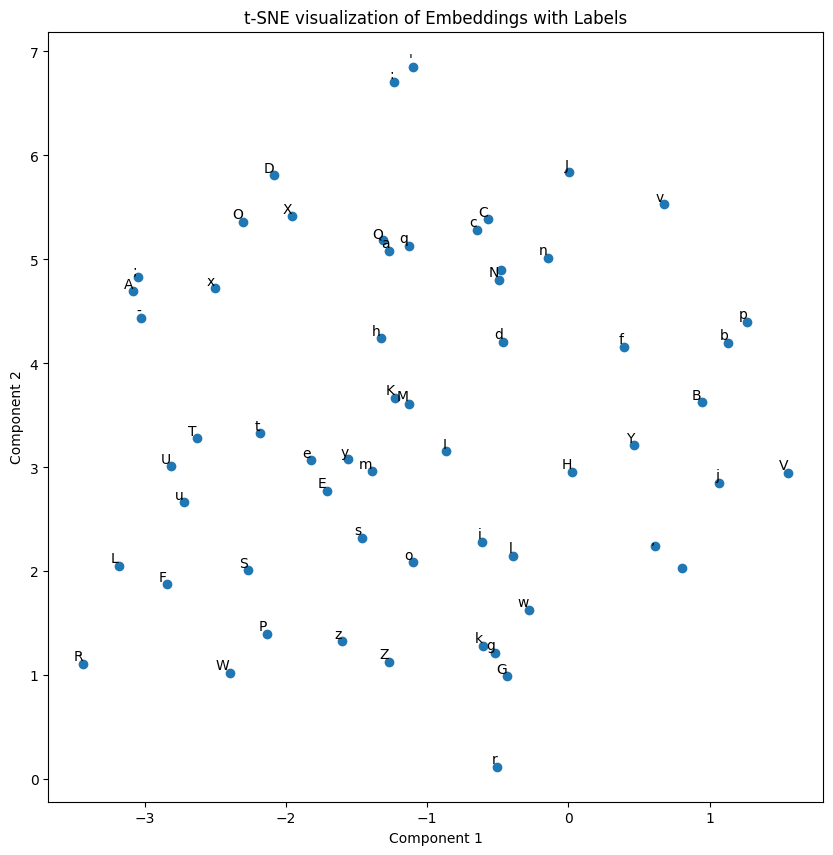

In [189]:
plt.figure(figsize=(10, 10))

# Scatter plot
plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1])

# Annotating each point with its character label
for i, word in enumerate(chars):
    plt.text(embeddings_2d[i, 0], embeddings_2d[i, 1], word, ha='right', va='bottom')

plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.title('t-SNE visualization of Embeddings with Labels')
plt.show()


In [190]:
def generate(model, itos, stoi, block_size, input_string, max_len=50):
    input_string = input_string[-block_size:]
    # If the input string is less than block_size, pad it with '.'
    input_string = '.' * (block_size - len(input_string)) + input_string if len(input_string) < block_size else input_string
    context = tokenize_string(input_string)
    name = ''
    for i in range(max_len):
        x = torch.tensor(context).view(1, -1).to(device)
        y_pred = model(x)
        ix = torch.distributions.categorical.Categorical(logits=y_pred).sample().item()
        ch = itos[ix]
        if ch == '.':
            break
        name += ch
        context = context[1:] + [ix]
    return name

In [191]:
generate(model, itos, stoi, block_size, 'SHUBH: Thou ')

'hand, Come onefer signardsed: Say wisd,, sative se'

In [192]:
# Save the model

torch.save(model.state_dict(), 'model.pth')

In [193]:
# Save itos and stoi

import json

with open('itos.json', 'w') as f:
    json.dump(itos, f)

with open('stoi.json', 'w') as f:
    json.dump(stoi, f)